# Approach: hybrid pipeline
- classic computer vision classica to identify candidate regions
- Responses API for a "structured evaluation" of Artwork Collision with severity, explanation and coordinates
- Show concrete example and one report per image

# 01 — Region Proposals with Azure AI Vision 4.0
This notebook demonstrates Dense Captions and Brand Detection to produce semantic region proposals (bounding boxes + captions).

**Prerequisites**
- Azure AI Vision 4.0 resource
- Python SDK: azure-ai-vision-imageanalysis
- An HD image path or SAS URL


# VisualFeatures

- **DENSE_CAPTIONS** provides bbox + text (“label”, “seam”, “button”, “zipper”, “logo” existing in the text)
- **OBJECTS** provides bbox +  object name (useful for “button”, “zipper”, “buckle”)
- **TAGS**: globali context signals (“logo”, “label”, “text”, “metal”, “leather”…) without bbox → useful to filter/weight different alternatives

# Constants and Libraries
- Environment setup
- Libraries
- Image path

In [1]:
import requests, json, os
from azure.ai.vision.imageanalysis import ImageAnalysisClient # !pip install azure-ai-vision-imageanalysis
from azure.ai.vision.imageanalysis.models import VisualFeatures # enum
from IPython.display import Image, display
from azure.core.credentials import AzureKeyCredential
from dotenv import load_dotenv # requires python-dotenv

if not load_dotenv("./../config/credentials_my.env"):
    print("Environment variables not loaded, cell execution stopped")
else:
    print("Environment variables have been loaded ;-)")

VISION_ENDPOINT = os.getenv('VISION_ENDPOINT', os.getenv("VISION_ENDPOINT"))
VISION_KEY = os.getenv('VISION_KEY', os.getenv("VISION_ENDPOINT"))
image_path = os.getenv('IMAGE_PATH', './images/1. ARTWORK COLLISION/J74Q10KAUG0-G6N3.png')

Environment variables have been loaded ;-)


# Smoke test

It's a *REST call* to the Image Analysis service using `features = Caption, Objects, Tags and DenseCaptions`.

This test demonstrates that:
- **captionResult** describes the whole picture.
- **denseCaptionsResult** returns several *candidate regions* together with their bounding boxes (that we may call "***semantic proposed regions***").
- **objectsResult** in our case is smpty (which may happen on fashion products or flat/uniform layouts).
- **tagsResult** returns global concepts (fashion, fabric, clothing...).

In [2]:
# A) Just Objects
# features = "Objects"
# B) Just Tags
# features = "Tags"
# C) DenseCaptions (if available in our Region)
# features = "DenseCaptions"
# D) Mix
features = "Caption,Objects,Tags,DenseCaptions"

api_version = "2023-10-01"  # tieni questa, visto che Caption funziona
url = f"{VISION_ENDPOINT}computervision/imageanalysis:analyze?api-version={api_version}&features={features}&model-version=latest"
headers = {"Ocp-Apim-Subscription-Key": VISION_KEY, "Content-Type": "application/octet-stream"}

with open(image_path, "rb") as f:
    r = requests.post(url, headers=headers, data=f.read(), timeout=60)
print("STATUS:", r.status_code)
print(r.text)

STATUS: 200
{"modelVersion":"2023-10-01","captionResult":{"text":"a pink sweater with a logo on it","confidence":0.844177782535553},"denseCaptionsResult":{"values":[{"text":"a pink sweater with a logo on it","confidence":0.844177782535553,"boundingBox":{"x":0,"y":0,"w":3000,"h":4000}},{"text":"a pink sweater with a logo on it","confidence":0.8374958038330078,"boundingBox":{"x":260,"y":543,"w":2414,"h":2888}},{"text":"a pink triangle with black text","confidence":0.7389377355575562,"boundingBox":{"x":993,"y":1118,"w":1040,"h":957}},{"text":"a pink sign with black letters","confidence":0.7743104100227356,"boundingBox":{"x":1125,"y":1171,"w":774,"h":254}},{"text":"a close up of a label","confidence":0.7756539583206177,"boundingBox":{"x":1192,"y":1458,"w":626,"h":554}},{"text":"a close up of a pink sweater","confidence":0.7313565611839294,"boundingBox":{"x":1058,"y":593,"w":874,"h":311}},{"text":"a pink question mark on a pink surface","confidence":0.7988315224647522,"boundingBox":{"x":138

## Region Proposals & Global Tags
### Purpose
Generate semantic region proposals (bounding boxes + short text) and global tags from the input garment image using Azure AI Vision 4.0. These proposals will be consumed by the LLM triage step to validate and classify defects (Artwork, Mesh, Trims).

### Inputs
- VISION_ENDPOINT — Azure AI Vision endpoint (same resource as your key).
- VISION_KEY — subscription key of the Vision resource.
- image_path — local path to the HD image (PNG/JPG).

### Requested features
- Caption — a single global description (context).
- DenseCaptions — multiple region boxes + captions (primary source of proposals).
- Tags — global semantic signals (no boxes).
- Objects — object boxes + names (secondary source; may be empty for some images).

### Cosa rappresenta l'immagine hotspots_heat.png
È esattamente una heatmap tecnica: colora l’intera superficie del capo in base all'"attività" locale (bordi, variazioni di tessuto, alta frequenza)

In [3]:
import os, json, requests

# Ensure VISION_ENDPOINT has a trailing slash; add it if missing.
def with_trailing_slash(url: str) -> str:
    return url if url.endswith("/") else url + "/"

api_version = "2023-10-01"
features = "Caption,Objects,Tags,DenseCaptions"

endpoint = with_trailing_slash(VISION_ENDPOINT)
url = f"{endpoint}computervision/imageanalysis:analyze?api-version={api_version}&features={features}&model-version=latest"
headers = {
    "Ocp-Apim-Subscription-Key": VISION_KEY,
    "Content-Type": "application/octet-stream"
}

with open(image_path, "rb") as f:
    resp = requests.post(url, headers=headers, data=f.read(), timeout=60)
resp.raise_for_status()
data = resp.json()

# Parse REST JSON to the same payload schema used by the SDK path
def to_bbox_dict(bb):
    return {"x": int(bb["x"]), "y": int(bb["y"]), "w": int(bb["w"]), "h": int(bb["h"])}

payload = {"context": {}, "proposals": [], "global_tags": []}

# Caption
cap = data.get("captionResult")
if cap and cap.get("text"):
    payload["context"] = {"text": cap["text"], "confidence": float(cap.get("confidence", 0.0))}

# Dense Captions
dense = data.get("denseCaptionsResult", {})
for v in dense.get("values", []):
    bb = v.get("boundingBox", {})
    payload["proposals"].append({
        "source": "dense_captions",
        "text": v.get("text", ""),
        "confidence": float(v.get("confidence", 0.0)),
        "bbox": to_bbox_dict(bb)
    })

# Objects
objs = data.get("objectsResult", {})
for o in objs.get("values", []):
    bb = o.get("boundingBox", {})
    name = o.get("name") or (o.get("tags", [{}])[0].get("name") if o.get("tags") else "object")
    payload["proposals"].append({
        "source": "objects",
        "text": name,
        "confidence": float(o.get("confidence", 0.0)),
        "bbox": to_bbox_dict(bb)
    })

# Tags
tags = data.get("tagsResult", {})
for t in tags.get("values", []):
    payload["global_tags"].append({
        "name": t.get("name", ""),
        "confidence": float(t.get("confidence", 0.0))
    })

# (Optional) simple dedup on overlapping boxes, same as SDK path
def iou(a, b):
    ax1, ay1, ax2, ay2 = a["x"], a["y"], a["x"]+a["w"], a["y"]+a["h"]
    bx1, by1, bx2, by2 = b["x"], b["y"], b["x"]+b["w"], b["y"]+b["h"]
    iw = max(0, min(ax2, bx2) - max(ax1, bx1))
    ih = max(0, min(ay2, by2) - max(ay1, by1))
    inter = iw * ih
    union = a["w"]*a["h"] + b["w"]*b["h"] - inter
    return 0.0 if union == 0 else inter / union

proposals_sorted = sorted(payload["proposals"], key=lambda p: (p["source"] != "dense_captions", -p["confidence"]))
selected = []
for p in proposals_sorted:
    if not selected:
        selected.append(p); continue
    if max(iou(p["bbox"], s["bbox"]) for s in selected) < 0.6:
        selected.append(p)

payload["proposals"] = selected[:12]

os.makedirs("artifacts", exist_ok=True)
with open("artifacts/proposals.json", "w", encoding="utf-8") as f:
    json.dump(payload, f, indent=2)

print(json.dumps(payload, indent=2))

{
  "context": {
    "text": "a pink sweater with a logo on it",
    "confidence": 0.844177782535553
  },
  "proposals": [
    {
      "source": "dense_captions",
      "text": "a black letter on a pink background",
      "confidence": 0.8652034401893616,
      "bbox": {
        "x": 1128,
        "y": 1200,
        "w": 167,
        "h": 198
      }
    },
    {
      "source": "dense_captions",
      "text": "a pink sweater with a logo on it",
      "confidence": 0.844177782535553,
      "bbox": {
        "x": 0,
        "y": 0,
        "w": 3000,
        "h": 4000
      }
    },
    {
      "source": "dense_captions",
      "text": "a pink sweater with a logo on it",
      "confidence": 0.8374958038330078,
      "bbox": {
        "x": 260,
        "y": 543,
        "w": 2414,
        "h": 2888
      }
    },
    {
      "source": "dense_captions",
      "text": "a pink question mark on a pink surface",
      "confidence": 0.7988315224647522,
      "bbox": {
        "x": 1381,
      

## Hot-spot map (edge + local variance + high-frequency energy)

✅ hotspots_heat.png

È la heatmap pura, codificata con la colormap TURBO (giallo/rosso = zone più “calde”).
Il colore indica intensità combinata di:

Edge (bordi forti)
Varianza locale (texture irregolare)
Energia alta frequenza (dettagli fini, aliasing)


Non è una mappa binaria di “punti rossi”, ma una mappa continua: zone più calde = più complessità locale.
Se vedi metà immagine più marcata, significa che quella regione ha molti dettagli o contrasti rispetto all’altra metà (es. sfondo uniforme vs area con pattern).


✅ hotspots_overlay.png

È la heatmap sovrapposta all’immagine originale (overlay con alpha blending).
Serve per contestualizzare le zone calde rispetto all’oggetto reale.
Più il colore tende al rosso/giallo, più la zona è “tecnicamente complessa” (potenziale rischio di collisione/aliasing). In altri termini:
- Giallo/rosso = zone con molti dettagli o discontinuità (piega, cuciture, pattern sovrapposti, aliasing).
- Blu/viola = zone uniformi (poca struttura).

Quindi è normale che gran parte del capo risulti “calda”: i tessuti hanno texture e pieghe.

Saved: artifacts/hotspots_heat.png, artifacts/hotspots_overlay.png
Saved: artifacts/proposals_reranked.json


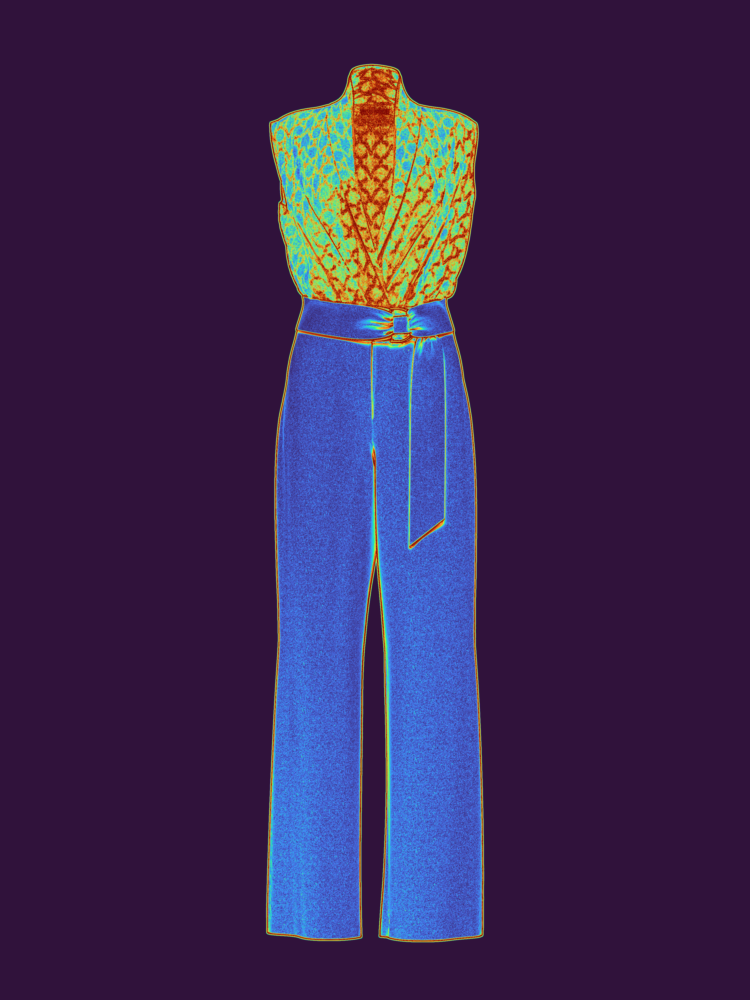

In [30]:
import os, json
import cv2 # requires opencv-python
import numpy as np
from matplotlib import pyplot as plt

# --- 1) Load image ---
img = cv2.imread(image_path, cv2.IMREAD_COLOR)
if img is None:
    raise ValueError(f"Impossibile leggere l'immagine: {image_path}")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

H, W = gray.shape[:2]

# --- 2) Edge map (Sobel magnitude) ---
gx = cv2.Sobel(gray, cv2.CV_32F, 1, 0, ksize=3)
gy = cv2.Sobel(gray, cv2.CV_32F, 0, 1, ksize=3)
mag = cv2.magnitude(gx, gy)
edge_map = mag

# --- 3) Local variance (sliding window) ---
# 9x9 window (tunable)
k = 9
mean = cv2.boxFilter(gray.astype(np.float32), ddepth=-1, ksize=(k, k))
mean_sq = cv2.boxFilter((gray.astype(np.float32)**2), ddepth=-1, ksize=(k, k))
var_map = np.maximum(mean_sq - mean**2, 0.0)

# --- 4) High-frequency energy (hi-pass) ---
# Blurred - original -> high-freq approx (or use Laplacian)
blur = cv2.GaussianBlur(gray, (0, 0), sigmaX=2, sigmaY=2)
hf = cv2.absdiff(gray, blur).astype(np.float32)

# --- 5) Normalizes each map on [0,1] safely (percentiles) ---
def robust_normalize(m):
    m = m.astype(np.float32)
    lo, hi = np.percentile(m, 2), np.percentile(m, 98)
    if hi - lo < 1e-6:
        return np.zeros_like(m, dtype=np.float32)
    m = np.clip((m - lo) / (hi - lo), 0, 1)
    return m

edge_n = robust_normalize(edge_map)
var_n  = robust_normalize(var_map)
hf_n   = robust_normalize(hf)

# --- 6) Weigthed fusion into a heatmap (weights are correlated with defects) ---
w_edge, w_var, w_hf = 0.4, 0.3, 0.3
heat = (w_edge * edge_n + w_var * var_n + w_hf * hf_n).astype(np.float32)

# --- 7) Show and save overlay ---
heat_color = cv2.applyColorMap((heat*255).astype(np.uint8), cv2.COLORMAP_TURBO)
overlay = cv2.addWeighted(img, 0.75, heat_color, 0.35, 0)

os.makedirs("artifacts", exist_ok=True)
cv2.imwrite("artifacts/hotspots_heat.png", heat_color)
cv2.imwrite("artifacts/hotspots_overlay.png", overlay)

print("Saved: artifacts/hotspots_heat.png, artifacts/hotspots_overlay.png")

# --- 8) (Optional) give a "technical risk" value to Cell 3 proposals ---
with open("artifacts/proposals.json", "r", encoding="utf-8") as f:
    payload = json.load(f)

def bbox_score(bbox, heatmap):
    x, y, w, h = bbox["x"], bbox["y"], bbox["w"], bbox["h"]
    x1, y1 = max(0, x), max(0, y)
    x2, y2 = min(W, x+w), min(H, y+h)
    if x2 <= x1 or y2 <= y1:
        return 0.0
    patch = heatmap[y1:y2, x1:x2]
    # Use high percentile (p90) per “peaks sensitiveness”
    p90 = float(np.percentile(patch, 90))
    return p90

for p in payload.get("proposals", []):
    p["tech_risk_p90"] = bbox_score(p["bbox"], heat)

# Reranking: semantic *and* tecnical (for testing)
payload["proposals"] = sorted(
    payload["proposals"],
    key=lambda r: ( -r.get("tech_risk_p90", 0.0), -r.get("confidence", 0.0) )
)

with open("artifacts/proposals_reranked.json", "w", encoding="utf-8") as f:
    json.dump(payload, f, indent=2)

print("Saved: artifacts/proposals_reranked.json")
display(Image("artifacts/hotspots_heat.png"))

## Visualizzazione “punti rossi” (picchi sopra soglia)
Partiamo dalla heatmap che abbiamo già in memoria (variabile `heat`) e produciamo solo i punti critici in overlay. È plug‑and‑play:

In [ ]:
import cv2, numpy as np, os

img = cv2.imread(image_path, cv2.IMREAD_COLOR)
assert img is not None, "Immagine non trovata"

# 1) Prendi la heatmap già calcolata (0..1). Se non l'hai in memoria, ricalcala come nella Cella 4 precedente.
#    Per rendere i picchi più visibili, fai una rimappatura di contrasto SOLO per visualizzazione:
heat_viz = heat.copy()
lo, hi = np.percentile(heat_viz, 10), np.percentile(heat_viz, 99.5)
heat_viz = np.clip((heat_viz - lo) / (hi - lo + 1e-6), 0, 1)

# 2) Threshold aggressivo: tieni SOLO i picchi
thr = 0.80  # prova 0.90 -> 0.95 a seconda del risultato
mask = (heat_viz >= thr).astype(np.uint8)

# 3) Pulizia leggera per isolare punti (evita macchie grandi)
kernel = np.ones((3,3), np.uint8)
mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

# 4) Colora in rosso i pixel "hot"
overlay_points = img.copy()
overlay_points[mask.astype(bool)] = (0, 0, 255)  # BGR

# 5) Blend finale
final_points = cv2.addWeighted(img, 0.8, overlay_points, 0.6, 0)

os.makedirs("artifacts", exist_ok=True)
cv2.imwrite("artifacts/hotspots_points.png", final_points)
print("Saved: artifacts/hotspots_points.png")
display(Image("artifacts/hotspots_points.png"))

In [ ]:

# Cella: ranking semplice delle proposals in base ai "punti rossi"
import json

with open("artifacts/proposals.json", "r", encoding="utf-8") as f:
    payload = json.load(f)

H, W = img.shape[:2]

def hot_ratio(bbox, mask):
    x, y, w, h = bbox["x"], bbox["y"], bbox["w"], bbox["h"]
    x1, y1 = max(0, x), max(0, y)
    x2, y2 = min(W, x+w), min(H, y+h)
    if x2 <= x1 or y2 <= y1:
        return 0.0
    patch = mask[y1:y2, x1:x2]
    return float(patch.sum()) / float(patch.size)  # % pixel "hot"

for p in payload.get("proposals", []):
    p["hot_ratio"] = hot_ratio(p["bbox"], mask)

payload["proposals"] = sorted(
    payload["proposals"],
    key=lambda r: (-r.get("hot_ratio", 0.0), -r.get("confidence", 0.0))
)

with open("artifacts/proposals_reranked_by_hot_ratio.json", "w", encoding="utf-8") as f:
    json.dump(payload, f, indent=2)

print("Saved: artifacts/proposals_reranked_by_hot_ratio.json")

## Produciamo i “tratti rossi” continui
- usa Canny per estrarre bordi sottili e continui (meglio dei picchi di heatmap);
- applica morfologia (dilatazione/chiusura) per trasformare i bordi in tratti spessi;
- filtra i piccoli componenti (niente puntinato);
- opzionale: tiene solo i segmenti lunghi (perimetro minimo).

Saved: artifacts/hotspots_redstrokes.png


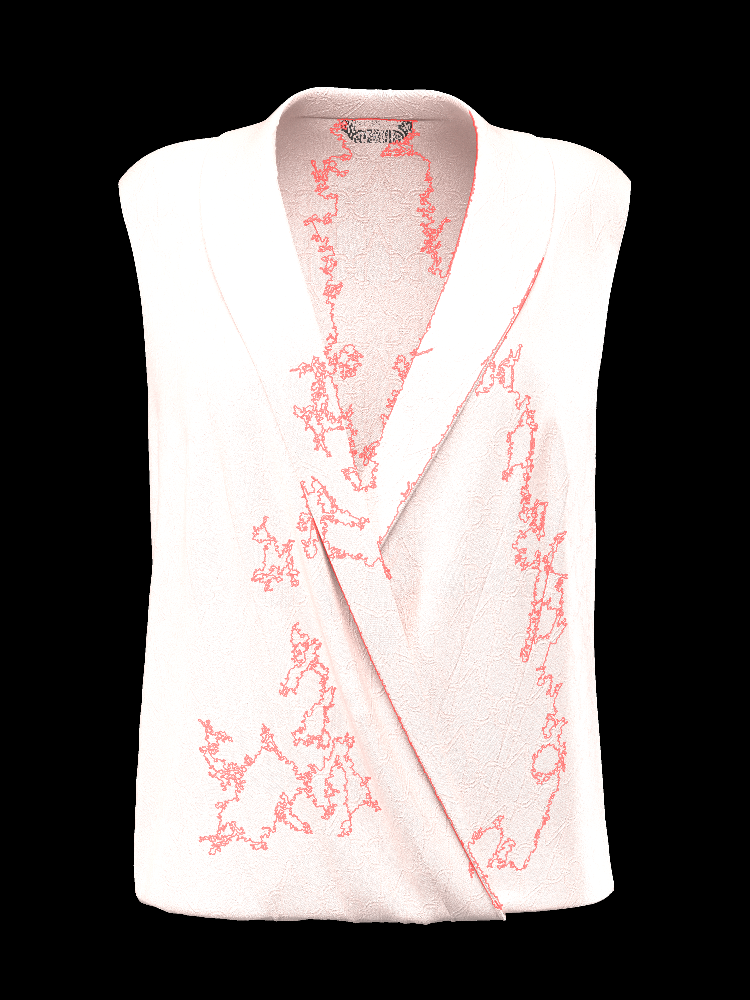

In [10]:

import cv2, numpy as np, os

# -------- Parametri semplici da regolare --------
CLAHE_CLIP = 2.0          # 1.5–3.0 (più alto = più contrasto locale)
CANNY_SCALE = 1.0         # 0.8–1.4 (scala sulle soglie auto)
DILATE_PX = 3             # spessore tratti finali: 2–5
MIN_AREA_FRAC = 0.001     # filtra pezzi piccoli (0.0005–0.003)
MIN_PERI_FRAC = 0.06      # filtra segmenti corti (0.04–0.1)
# ------------------------------------------------

img = cv2.imread(image_path, cv2.IMREAD_COLOR)
assert img is not None, f"Impossibile leggere {image_path}"
H, W = img.shape[:2]

# 1) Maschera capo: tutto ciò che non è nero (sfondo) -> True
gray0 = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
garment_mask = (gray0 > 8).astype(np.uint8)  # 1=capo, 0=sfondo
# piccoli buchi nel bordo -> chiudi
garment_mask = cv2.morphologyEx(garment_mask, cv2.MORPH_CLOSE,
                                cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7,7)), iterations=1)

# 2) Pre‑enhance: CLAHE per far emergere bordi nel tessuto
clahe = cv2.createCLAHE(clipLimit=CLAHE_CLIP, tileGridSize=(8,8))
gray = clahe.apply(gray0)

# 3) Canny auto‑tuned (mediana) limitato al capo
blur = cv2.GaussianBlur(gray, (3,3), 0)
v = np.median(blur[garment_mask.astype(bool)]) if garment_mask.sum() > 0 else np.median(blur)
low = int(max(0, 0.66 * v * CANNY_SCALE))
high = int(min(255, 1.33 * v * CANNY_SCALE))
edges = cv2.Canny(blur, low, high, L2gradient=True)
edges[garment_mask == 0] = 0  # niente bordi fuori dal capo

# 4) Connetti leggermente e ispessisci, ma NON riempire
closed = cv2.morphologyEx(edges, cv2.MORPH_CLOSE,
                          cv2.getStructuringElement(cv2.MORPH_RECT, (3,3)), iterations=1)
thick = cv2.dilate(closed, cv2.getStructuringElement(cv2.MORPH_RECT, (DILATE_PX, DILATE_PX)), iterations=1)

# 5) Filtra componenti troppo piccoli/rumorosi (niente puntinato)
contours, _ = cv2.findContours(thick, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
mask = np.zeros((H, W), dtype=np.uint8)
min_area = (W*H) * MIN_AREA_FRAC
min_peri = (W + H) * MIN_PERI_FRAC

for cnt in contours:
    area = cv2.contourArea(cnt)
    peri = cv2.arcLength(cnt, closed=True)
    if area >= min_area and peri >= min_peri:
        # Disegna come bordo spesso (tratto), NON fill
        cv2.drawContours(mask, [cnt], -1, color=255, thickness=max(2, DILATE_PX))

# 6) Overlay: solo i tratti in rosso
overlay = img.copy()
overlay[mask > 0] = (0, 0, 255)  # BGR
final = cv2.addWeighted(img, 0.8, overlay, 0.6, 0)

os.makedirs("artifacts", exist_ok=True)
cv2.imwrite("artifacts/hotspots_redstrokes.png", final)
print("Saved: artifacts/hotspots_redstrokes.png")

display(Image("artifacts/hotspots_redstrokes.png"))

In [5]:

# Output:
#  - artifacts/triangle_detect.png        (triangolo rilevato)
#  - artifacts/triangle_fade_overlay.png  (rosso = artwork sbiadito)
#  - artifacts/triangle_fade_debug.png    (fasce di misura su bordo e anelli in/out)
#  - artifacts/triangle_metrics.json      (metriche numeriche)
import cv2, numpy as np, json, os, math

# -------- Parametri principali (toccane pochi) --------
MAX_SIDE          = 1400     # riduci immagini grandi per robustezza/velocità
CANNY_LO_HI       = (60, 160) # soglie Canny (60–160 di default; alza se troppo rumore)
APPR_EPS_FRAC     = 0.02     # 0.015–0.03: epsilon per approxPolyDP (fitting del triangolo)
MIN_TRI_AREA_FRAC = 0.02     # area minima triangolo vs immagine (2%): 0.01–0.04
EDGE_BAND_PX      = 8        # spessore fascia intorno ai lati per edge strength
RING_PX           = 12       # spessore anello interno/esterno per confronto di contrasto
FADE_THRESH       = 0.60     # soglia sul fade_risk per colorare in rosso
# ------------------------------------------------------

# 0) Carica immagine
img0 = cv2.imread(image_path, cv2.IMREAD_COLOR)
assert img0 is not None, f"Impossibile leggere {image_path}"
H0, W0 = img0.shape[:2]

# 1) Downscale (opzionale ma consigliato)


display(Image("artifacts/artwork_collision_boxes.png"))

RuntimeError: Triangolo non rilevato: prova ad abbassare CANNY_LO_HI o MIN_TRI_AREA_FRAC.